In [1]:
from jetutils.jet_finding import *
from jetutils.definitions import *
from jetutils.plots import *
from jetutils.clustering import *
from jetutils.data import *
import colormaps

%load_ext autoreload
%autoreload 2
%matplotlib inline

/storage/homefs/hb22g102/miniforge3/envs/env11_2/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [8]:
data_handlers = {}
for varname in ["u", "v", "s"]:
    dh = DataHandler.from_specs("ERA5", "plev", varname, "6H", "all", None, -80, 40, 15, 80, [175, 200, 225, 250, 300, 350], reduce_da=False)
    data_handlers[varname] = dh
data_handler = DataHandler.from_several_dhs(data_handlers)
exp = JetFindingExperiment(data_handler)
ds = exp.ds

all_jets_one_df, all_jets_over_time, flags = exp.track_jets()
props_as_ds_uncat = exp.props_as_ds(False)
props_as_ds = exp.props_as_ds(True)
da = data_handlers[2].da

jet_pos_da = jet_position_as_da(da, props_as_ds_uncat, all_jets_one_df, exp.path)
jet_pos_da = jet_pos_da.interp(time=da.time.values)
props_as_ds["nao"] = get_nao(props_as_ds)
overlap = (jet_pos_da > 0).any("lat").all("jet")
props_as_ds["double_jet_index"] = overlap.sel(lon=slice(-20, None, None)).mean("lon")

subset = ["mean_lon", "mean_lat", "mean_lev", "width", "persistence", "spe_star"]
props_as_np = props_as_ds[subset].sel(time=props_as_ds.time.dt.season=="JJA").to_dataarray().interpolate_na("time", method="nearest", fill_value="extrapolate").values
props_as_np = props_as_np.transpose(1, 0, 2).reshape(props_as_np.shape[1], props_as_np.shape[0] * props_as_np.shape[2]) 

exp_T = DataHandler.from_specs(
    "ERA5", "surf", "t", "6H", "all", "JJA", -30, 40, 30, 75, 250, 'hourofyear', {'hourofyear': ('win', 4 * 15)}, None,
)
da_T = exp_T.da.load()

exp_pvs = DataHandler.from_specs("ERA5", "surf", "pvs", "6H", "all", "JJA", *data_handlers[2].region, 250, "hourofyear", {"hourofyear": ("win", 60)})
da_pvs = exp_pvs.da.load()

exp_z = DataHandler.from_specs(
    "ERA5", "plev", "z", "6H", "all", "JJA", *data_handlers[2].region, 500, 'hourofyear', {'hourofyear': ('win', 4 * 15)}, None,
)
da_z = exp_z.da.load()

exp_tp = DataHandler.from_specs(
    "ERA5", "surf", "tp", "6H", "all", "JJA", -30, 40, 30, 75, 250, 'hourofyear', {'hourofyear': ('win', 4 * 15)}, None,
)
da_tp = exp_tp.da.load()

exp_s10 = DataHandler.from_specs(
    "ERA5", "surf", "s10", "6H", "all", "JJA", -30, 40, 30, 75, 250, 'hourofyear', {'hourofyear': ('win', 4 * 15)}, None,
)
da_s10 = exp_s10.da.load()

exp_anoms = DataHandler.from_specs(
    "ERA5", "plev", "s", "6H", "all", "JJA", *data_handlers[2].region, 250, 'hourofyear', {'hourofyear': ('win', 4 * 15)}, None,
)
da_anoms = exp_anoms.da.load()

In [11]:
from itertools import product
quantiles = np.nanquantile(props_as_np, q=[.05, .95], axis=0)
props_as_np_digitized = np.zeros_like(props_as_np, dtype=int)
for i, prop_as_np in enumerate(props_as_np.T):
    props_as_np_digitized[:, i] = np.digitize(prop_as_np, quantiles[:, i], right=False)
titles = [', '.join(ouais) for ouais in product(subset, props_as_ds.jet.values, [r'bottom $5\%$', r'top $5\%$'])]

ncat = len(quantiles) + 1
unique_labels = np.arange(ncat)
mask_extremes = []
for i, prop_as_np in enumerate(props_as_np_digitized.T):
    masks = prop_as_np[:, None] == np.asarray([0, 2])[None, :]
    mask_extremes.append(masks)
mask_extremes = np.concatenate(mask_extremes, axis=1)

## precip anomalies

100%|██████████| 24/24 [00:58<00:00,  2.42s/it]


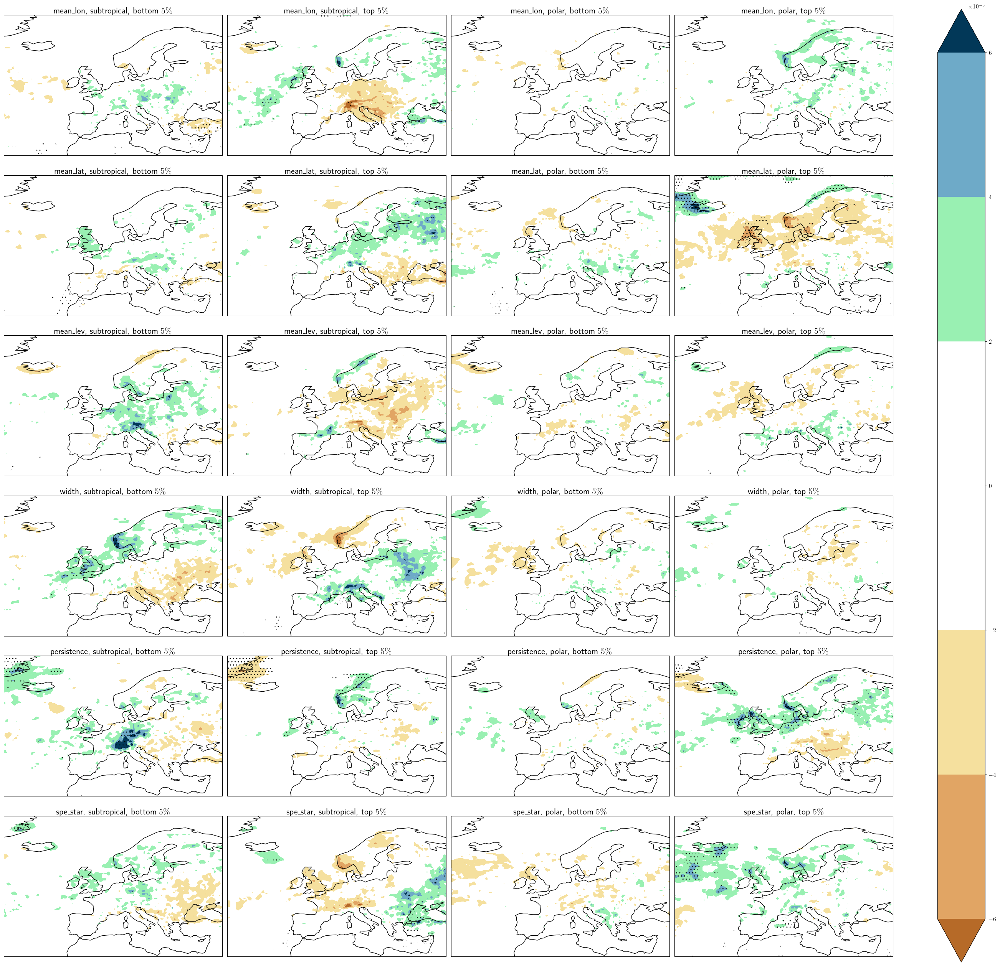

In [16]:
clu = Clusterplot(len(subset), 4, region=get_region(da_tp))
_ = clu.add_any_contour_from_mask(da_tp, mask_extremes, stippling=True, cmap=colormaps.precip_diff_12lev, transparify=1, draw_cbar=True, titles=titles, q=0.999, levels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/tp.png')

## s anom

100%|██████████| 24/24 [01:12<00:00,  3.03s/it]


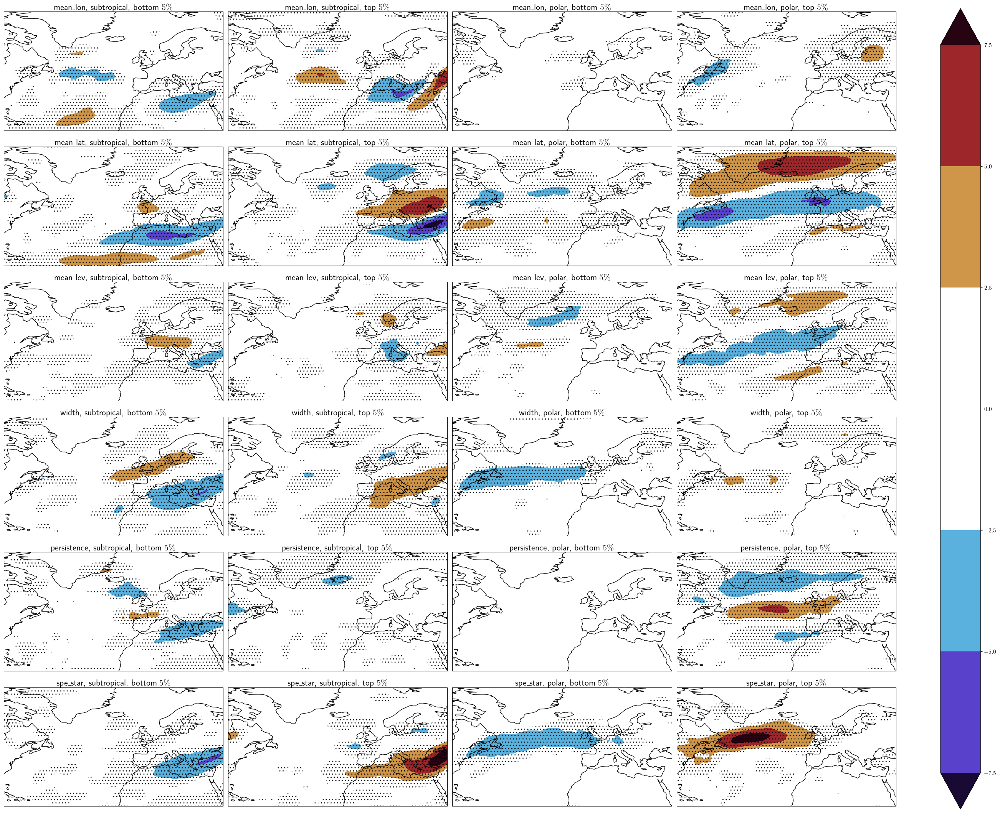

In [15]:
clu = Clusterplot(len(subset), 4, region=get_region(da_anoms))
_ = clu.add_any_contour_from_mask(da_anoms, mask_extremes, stippling=True, cmap=colormaps.fusion_r, transparify=1, draw_cbar=True, titles=titles, q=0.999, levels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/anoms.png')

## surf wind anomalies

100%|██████████| 24/24 [01:04<00:00,  2.68s/it]


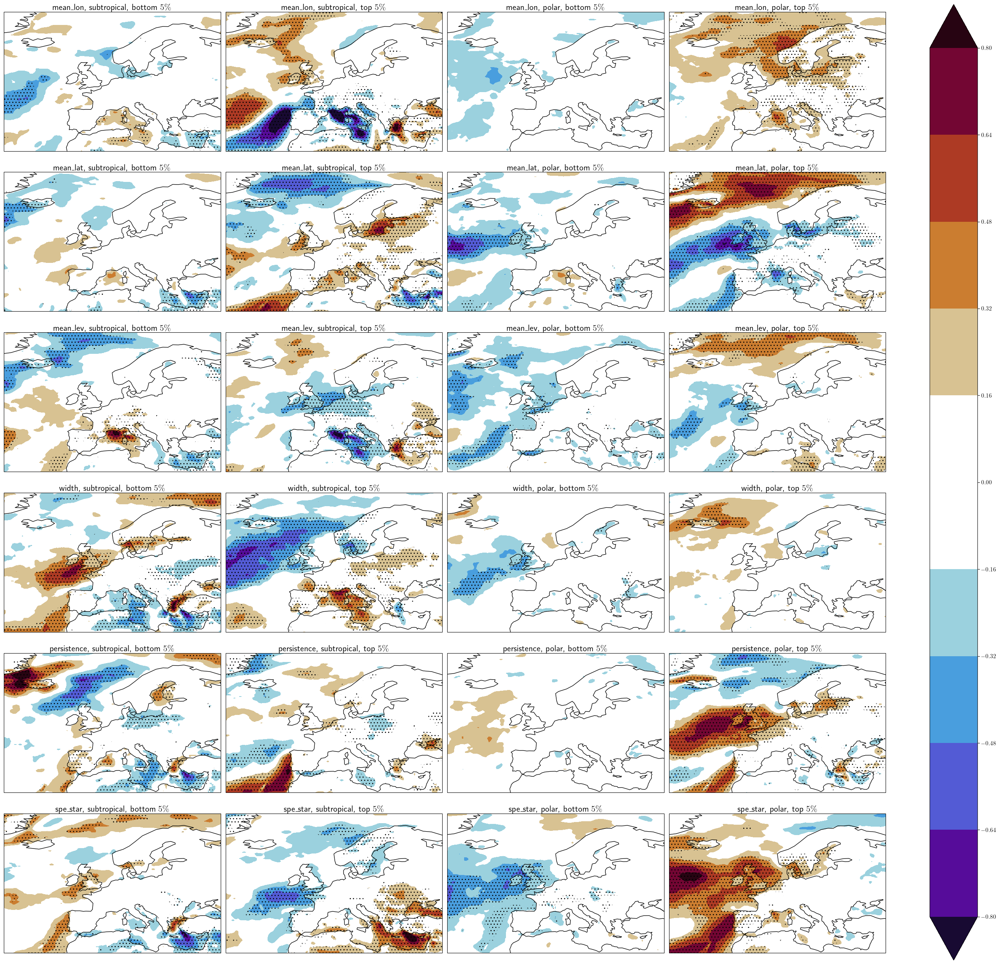

In [44]:
clu = Clusterplot(len(subset), 4, region=get_region(da_s10))
_ = clu.add_any_contour_from_mask(da_s10, mask_extremes, stippling=True, cmap=colormaps.fusion_r, transparify=1, draw_cbar=True, titles=titles, q=0.999, nlevels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/s10.png')

## Temperature anomalies

  0%|          | 0/24 [00:00<?, ?it/s]100%|██████████| 24/24 [00:33<00:00,  1.40s/it]


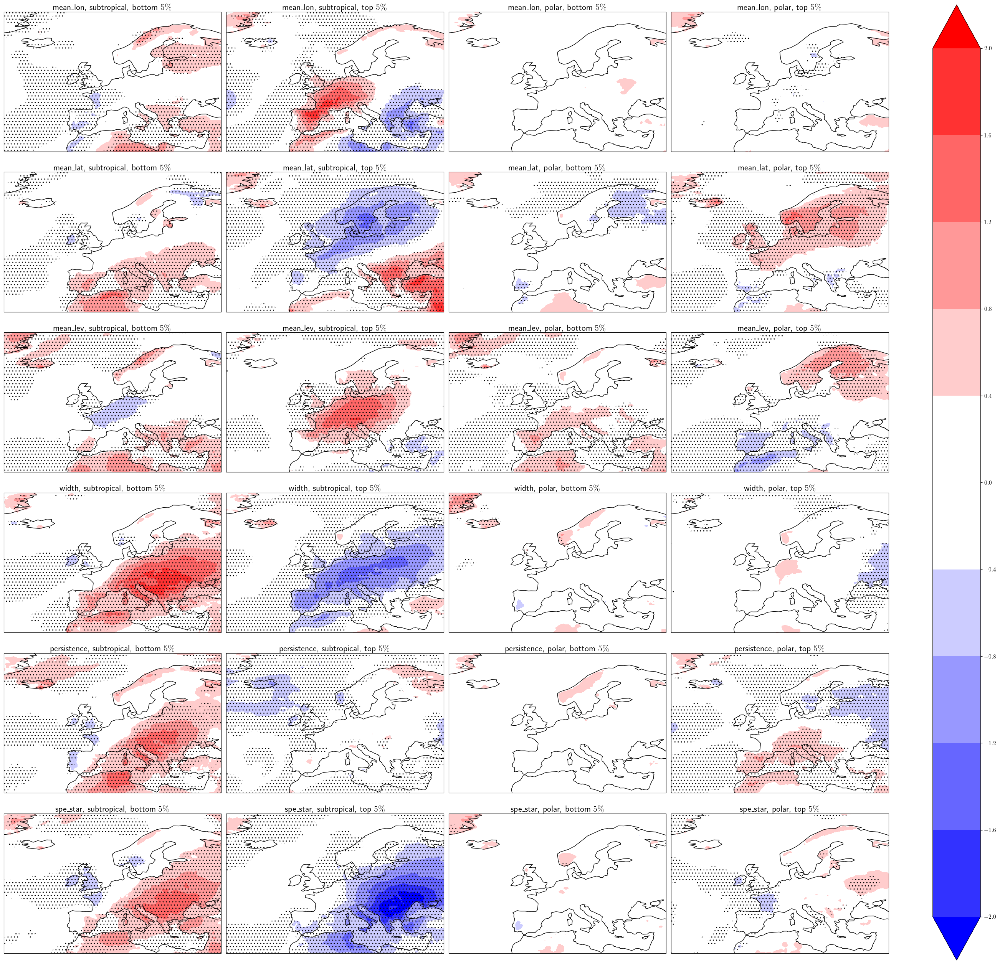

In [45]:
clu = Clusterplot(len(subset), 4, region=get_region(da_T))
_ = clu.add_any_contour_from_mask(da_T, mask_extremes, stippling=True, cmap='bwr', transparify=1, draw_cbar=True, titles=titles, q=0.999, nlevels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/t.png')

## Jet position

In [46]:
jet_pos_da_summer = jet_pos_da.sel(time=jet_pos_da.time.dt.season=="JJA")

100%|██████████| 24/24 [00:00<00:00, 69.01it/s]


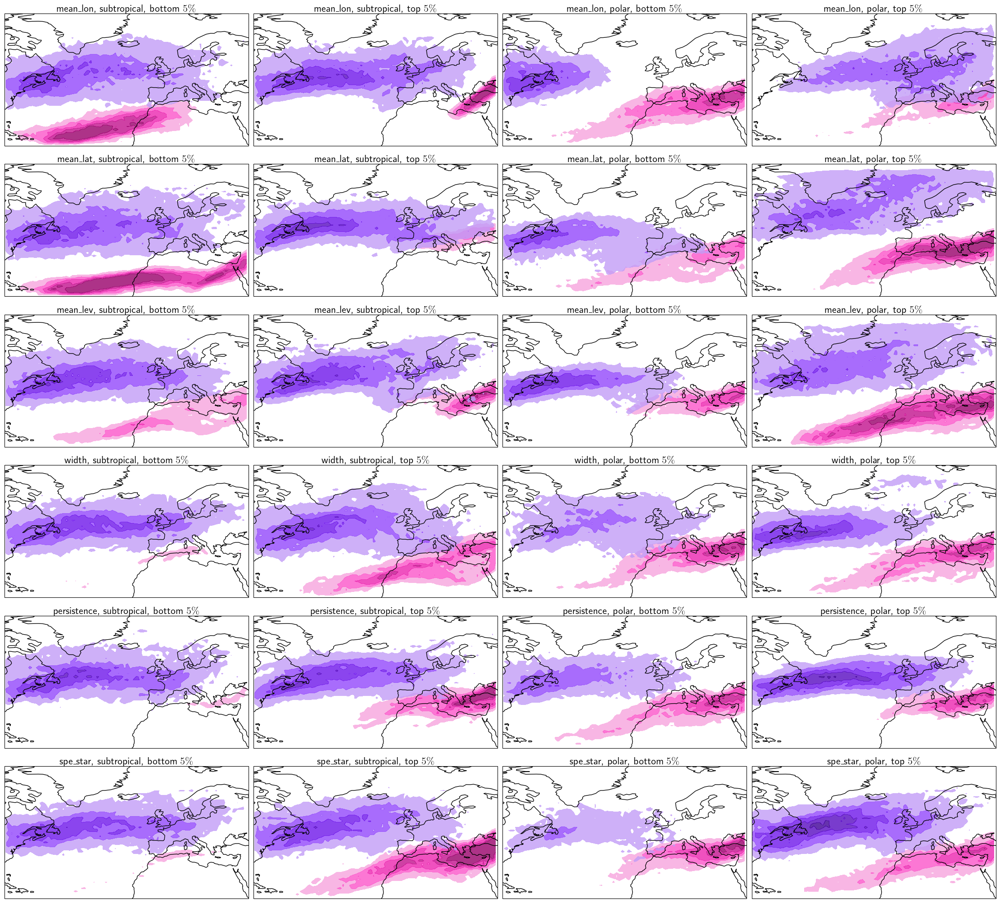

In [47]:
clu = Clusterplot(len(subset), 4, region=exp.region)
# _ = clu.add_any_contour_from_mask(da_T, mask_extremes, type='contour', cmap='bwr', clabels=True, nlevels=3, titles=titles)
# clu.resize_relative([0.85, 0.95])
_ = clu.add_any_contour_from_mask(jet_pos_da_summer[:, 0], mask_extremes, stippling=False, cmap=MYPINKS, transparify=.8, draw_cbar=False, q=0.98, titles=titles)
_ = clu.add_any_contour_from_mask(jet_pos_da_summer[:, 1], mask_extremes, stippling=False, cmap=MYPURPLES, transparify=.8, draw_cbar=False, q=0.98)
clu.resize_relative([0.85, 0.95])
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/jet_pos.png')

## Anticyclonic streamers

  0%|          | 0/24 [00:00<?, ?it/s]100%|██████████| 24/24 [03:09<00:00,  7.88s/it]


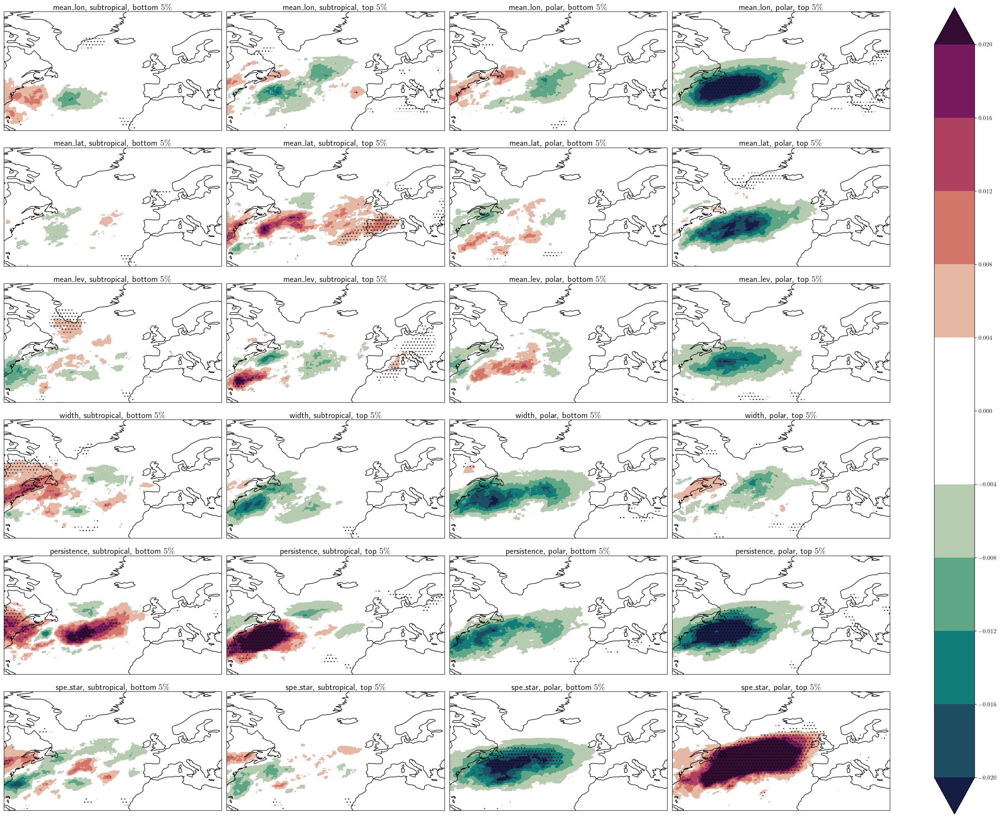

In [48]:
import warnings
clu = Clusterplot(len(subset), 4, region=get_region(da_pvs))
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    _ = clu.add_any_contour_from_mask(da_pvs.sel(type="anti"), mask_extremes, stippling=True, cmap=colormaps.curl, transparify=1, draw_cbar=True, titles=titles, q=0.99, nlevels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/apvs.png')

## Cyclonic streamers

100%|██████████| 24/24 [03:08<00:00,  7.84s/it]


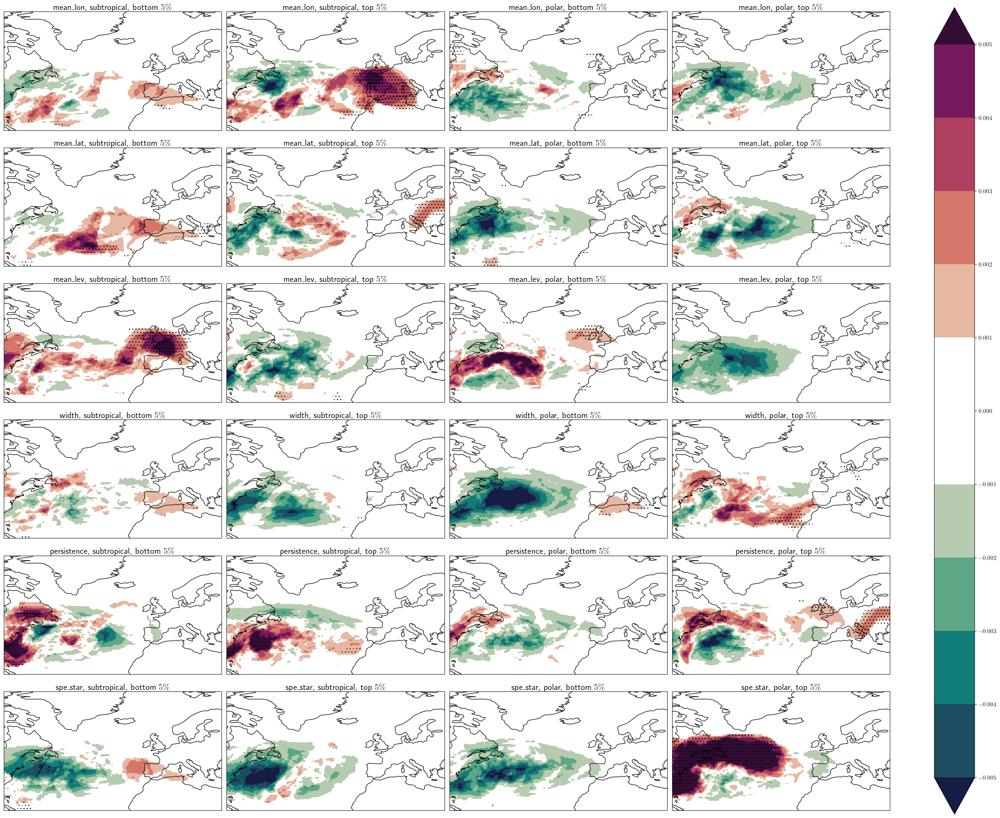

In [49]:
clu = Clusterplot(len(subset), 4, region=get_region(da_pvs))
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    _ = clu.add_any_contour_from_mask(da_pvs.sel(type="cycl"), mask_extremes, stippling=True, cmap=colormaps.curl, transparify=1, draw_cbar=True, titles=titles, q=0.99, nlevels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/cpvs.png')

100%|██████████| 24/24 [01:21<00:00,  3.38s/it]


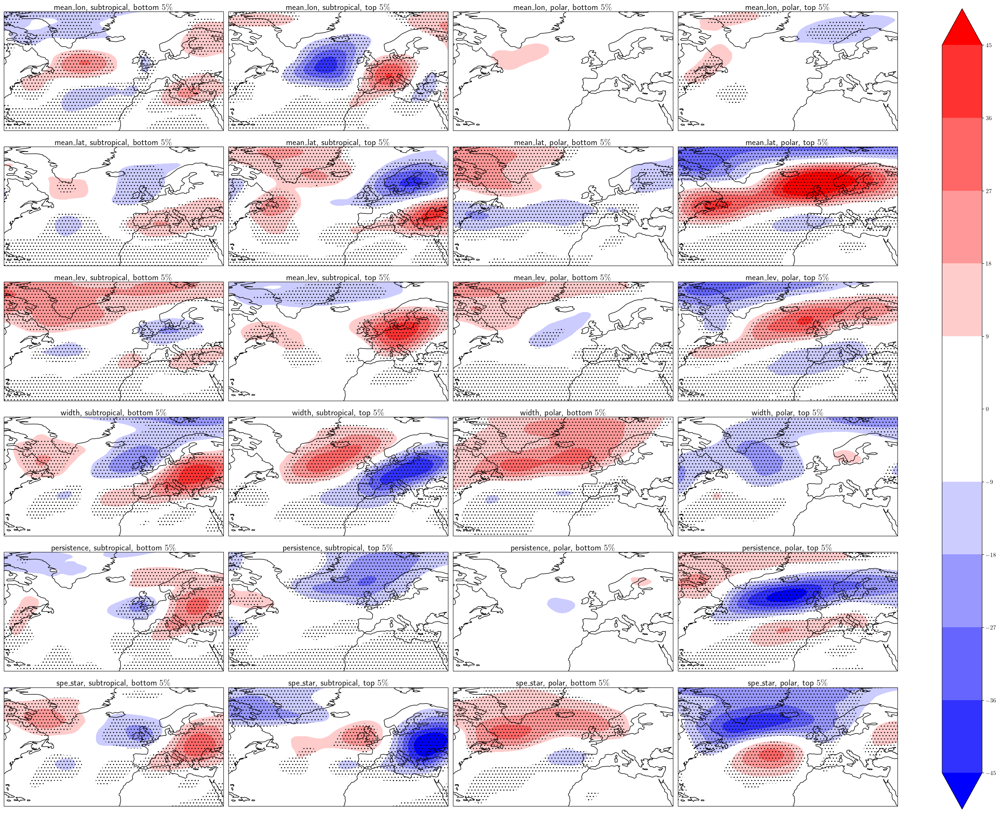

In [50]:
import scipy.constants as co

clu = Clusterplot(len(subset), 4, region=get_region(da_z))
_ = clu.add_any_contour_from_mask(da_z / co.g, mask_extremes, stippling=True, cmap="bwr", transparify=1, draw_cbar=True, titles=titles, q=0.998, nlevels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/z.png')

# Wind components

## $u$

In [51]:
ds_summer = exp.ds.sel(time=exp.ds.time.dt.season=="JJA").load()

100%|██████████| 24/24 [00:06<00:00,  3.70it/s]


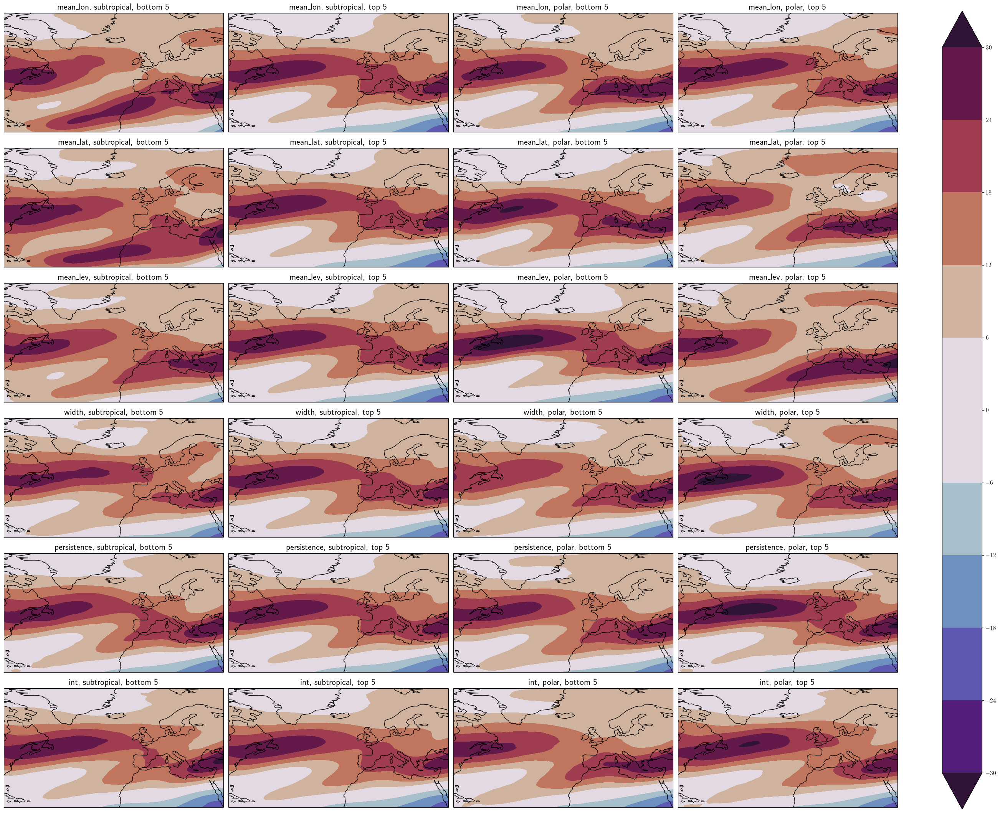

In [11]:
clu = Clusterplot(len(subset), 4, region=exp.region)
_ = clu.add_any_contour_from_mask(ds_summer["u"], mask_extremes, stippling=False, cmap="twilight_shifted", transparify=0, draw_cbar=True, titles=titles, q=0.99, nlevels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/u.png')

  8%|▊         | 2/24 [00:00<00:09,  2.26it/s]100%|██████████| 24/24 [00:06<00:00,  3.73it/s]


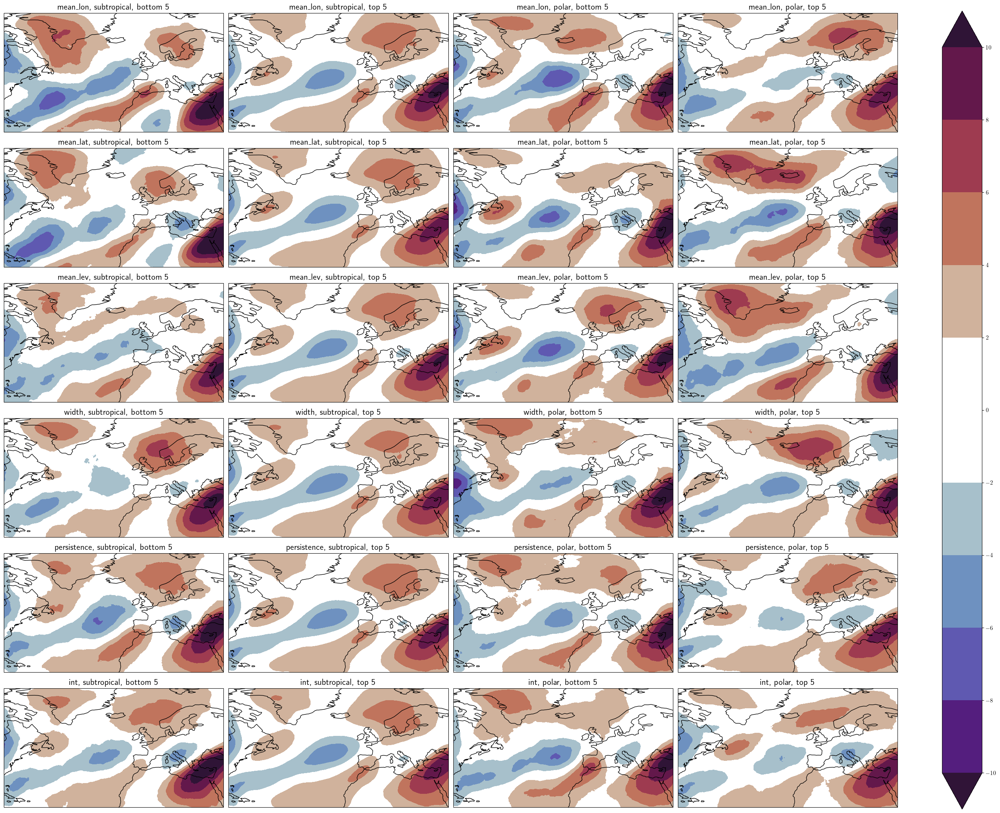

In [12]:
clu = Clusterplot(len(subset), 4, region=exp.region)
_ = clu.add_any_contour_from_mask(ds_summer["v"], mask_extremes, stippling=False, cmap="twilight_shifted", transparify=1, draw_cbar=True, titles=titles, q=0.99, nlevels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/v.png')

  0%|          | 0/24 [00:00<?, ?it/s]100%|██████████| 24/24 [00:06<00:00,  3.67it/s]


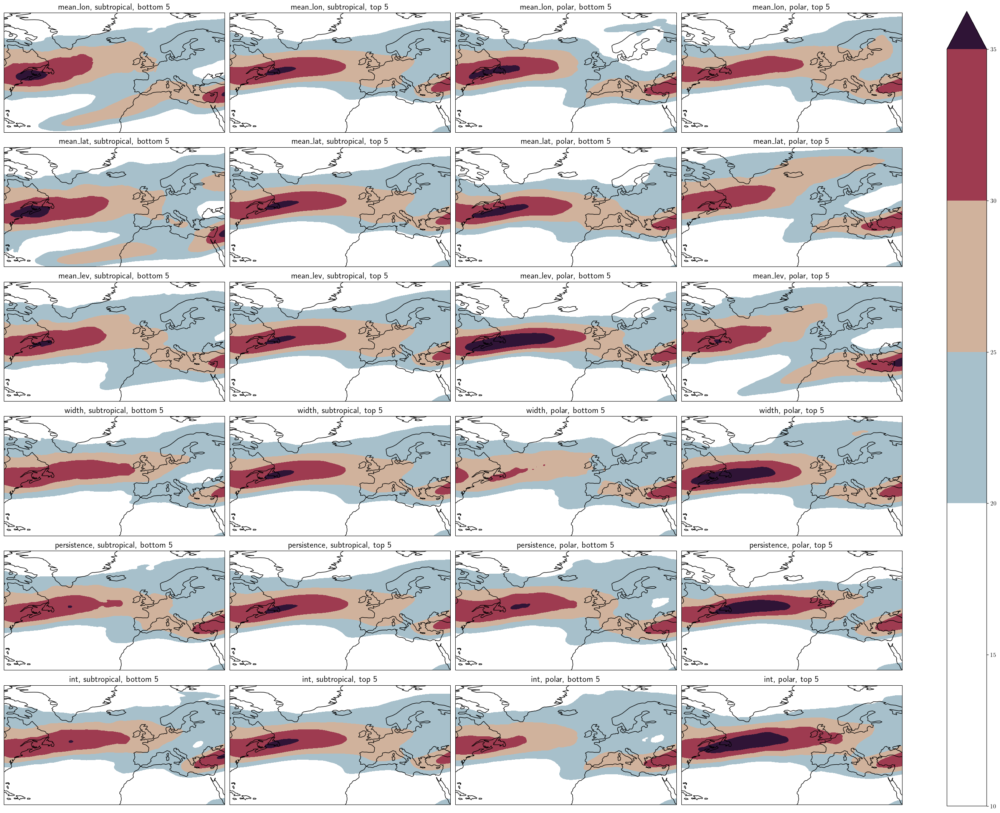

In [13]:
clu = Clusterplot(len(subset), 4, region=get_region(da_z))
_ = clu.add_any_contour_from_mask(ds_summer["s"], mask_extremes, stippling=False, cmap="twilight_shifted", transparify=2, draw_cbar=True, titles=titles, q=0.99, nlevels=6)
plt.savefig(f'{FIGURES}/jet_index_extremes_composites/s.png')